In [2]:
import torch
import numpy as np
import matplotlib.pyplot as plt

In [7]:
img_t = torch.randn(3, 5, 5)
weights = torch.tensor([.2126, .7152, .0722])
batch_t = torch.randn(2, 3, 5, 5)

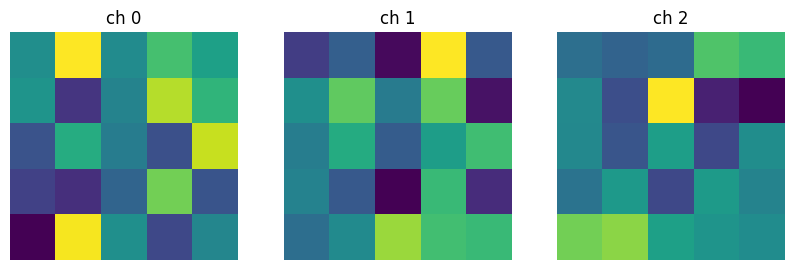

In [6]:
plt.figure(figsize=(10, 3))
for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.imshow(img_t[i].numpy())
    plt.title(f'ch {i}')
    plt.axis('off')


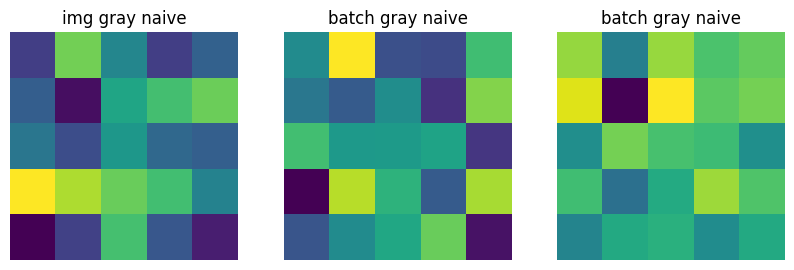

In [8]:
img_gray_naive = img_t.mean(-3)
batch_gray_naive = batch_t.mean(-3)
plt.figure(figsize=(10, 3))
plt.subplot(1, 3, 1)
plt.imshow(img_gray_naive.numpy())
plt.title('img gray naive')
plt.axis('off')
plt.subplot(1, 3, 2)
plt.imshow(batch_gray_naive[0].numpy())
plt.title('batch gray naive')
plt.axis('off')
plt.subplot(1, 3, 3)
plt.imshow(batch_gray_naive[1].numpy())
plt.title('batch gray naive')
plt.axis('off')

plt.show()

In [9]:
img_t

tensor([[[ 0.2666,  0.9075, -0.1867,  0.0147,  1.1475],
         [-0.4116, -2.6089,  0.6238,  0.9115,  0.9868],
         [ 0.7241,  1.2028,  0.1213, -1.0633,  0.1216],
         [ 2.2615,  1.3236, -0.7756,  1.8504,  0.6360],
         [-1.1441, -1.4367,  1.2716,  0.3612, -0.7559]],

        [[-1.2914,  1.4696, -1.3843, -1.2865, -0.0474],
         [ 0.2526, -0.0471,  0.9008,  0.7400,  0.3492],
         [-0.2072, -1.5086,  1.5946,  0.0114, -2.1246],
         [ 0.7246,  1.6013,  0.3481,  0.4600, -0.9509],
         [-0.6634,  0.9994, -0.1473, -1.0653, -0.5523]],

        [[-0.3697, -0.0937,  1.8596, -0.1181, -1.7182],
         [-0.5386,  0.3610, -0.4543,  0.1070,  0.8862],
         [-0.6524, -0.7723, -1.0091,  0.5986,  1.3346],
         [ 0.6085, -0.0951,  2.6204, -0.5776,  0.4931],
         [-0.7221, -0.8989,  0.6632, -0.1551, -0.7156]]])

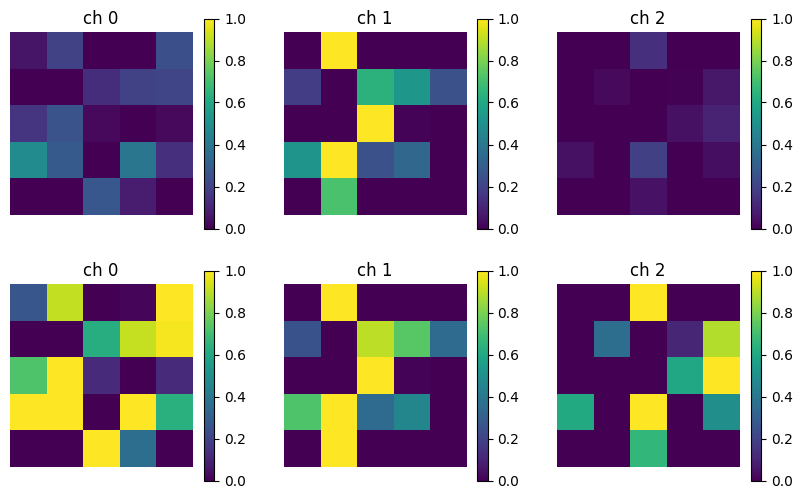

In [29]:
unsqueezed_weights = weights.unsqueeze(-1).unsqueeze_(-1)
img_weights = img_t * unsqueezed_weights
batch_weights = batch_t * unsqueezed_weights
plt.figure(figsize=(10, 6))
for i in range(3):
    plt.subplot(2, 3, i + 1)
    plt.imshow(img_weights[i].numpy(), vmin=0, vmax=1)
    plt.colorbar()
    plt.title(f'ch {i}')
    plt.axis('off')
    plt.subplot(2, 3, i + 4)
    plt.imshow(img_t[i].numpy(), vmin=0, vmax=1)
    plt.colorbar()
    plt.title(f'ch {i}')
    plt.axis('off')
    

In [38]:
img_named = img_t.refine_names('channels', 'rows', 'columns')
img_named[..., :3].shape

torch.Size([3, 5, 3])

In [39]:
points = torch.tensor([[4.0, 1.0], [5.0, 3.0], [2.0, 1.0]])
points.storage()

C:\Users\nq9093\AppData\Local\Temp\ipykernel_7936\2923139482.py:2: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  points.storage()


 4.0
 1.0
 5.0
 3.0
 2.0
 1.0
[torch.storage.TypedStorage(dtype=torch.float32, device=cpu) of size 6]

In [42]:
points_storage = points.storage()
points_storage[0] = 2.0
points

tensor([[2., 1.],
        [5., 3.],
        [2., 1.]])

In [43]:
points.zero_()
points


tensor([[0., 0.],
        [0., 0.],
        [0., 0.]])

In [46]:
points = torch.tensor([[4.0, 1.0], [5.0, 3.0], [2.0, 1.0]])
second_point = points[1]
second_point.storage_offset()

2

In [47]:
second_point.size()


torch.Size([2])

In [50]:
points_t = points.t()
id(points.storage()) == id(points_t.storage())

True

C:\Users\nq9093\AppData\Local\Temp\ipykernel_7936\4247593721.py:2: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_arr = imageio.imread("./../w2/bobby.jpg")


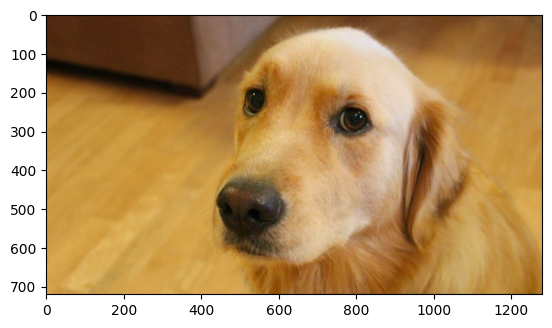

In [55]:
import imageio 
img_arr = imageio.imread("./../w2/bobby.jpg")
plt.imshow(img_arr)

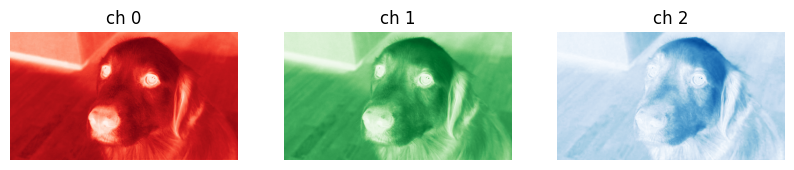

In [59]:
plt.figure(figsize=(10, 3))
for i in range(3): 
    plt.subplot(1, 3, i + 1)
    if i == 0: 
        cmap = 'Reds'
    elif i == 1:
        cmap = 'Greens'
    else:
        cmap = 'Blues' 
    plt.imshow(img_arr[..., i], cmap=cmap)
    plt.title(f'ch {i}')
    plt.axis('off')

In [63]:
img = torch.from_numpy(img_arr)
out = img.permute(2, 0, 1)
out.shape

torch.Size([3, 720, 1280])

In [78]:
import os 
import cv2
data_dir = "./../w2/"
filenames = [name for name in os.listdir(data_dir) if name.endswith(".png") or name.endswith(".jpg")]

for filename in filenames:
    img_arr = cv2.imread(os.path.join(data_dir, filename))
    img_cropped = img_arr[:256, :256]



No face detected in bobby.jpg
No face detected in dog.png
No face detected in horse.jpg


In [74]:
data_dir = "./"
filenames = [name for name in os.listdir(data_dir) if name.endswith(".png")]
print(filenames)

batch_size = 3
batch = torch.zeros(batch_size, 3, 256, 256, dtype=torch.uint8)
for i, filename in enumerate(filenames):
    img_arr = imageio.imread(os.path.join(data_dir, filename))
    img_t = torch.from_numpy(img_arr).permute(2, 0, 1)
    batch[i] = img_t

['bobby_cropped.png', 'dog_cropped.png', 'horse_cropped.png']


C:\Users\nq9093\AppData\Local\Temp\ipykernel_7936\1958554244.py:8: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_arr = imageio.imread(os.path.join(data_dir, filename))


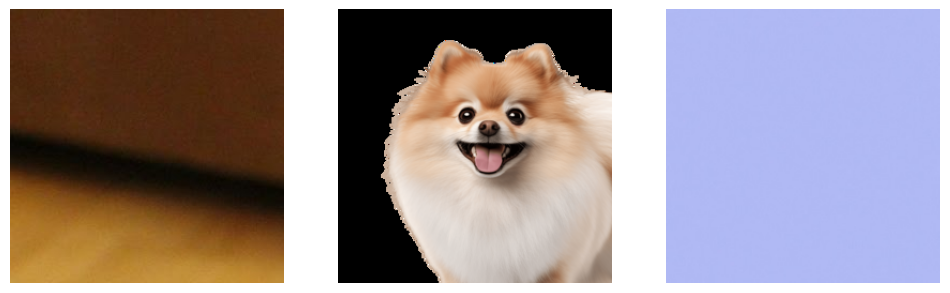

In [77]:
plt.figure(figsize=(12, 6))
for i in range(batch_size):
    plt.subplot(1, batch_size, i + 1)
    plt.imshow(batch[i].permute(1, 2, 0))
    plt.axis('off')

In [80]:
batch = batch.float()
batch /= 255.0

In [83]:
n_channels = batch.shape[1]
for c in range(n_channels):
    print(c)
    mean = torch.mean(batch[:, c])
    std = torch.std(batch[:, c])
    batch[:, c] = (batch[:, c] - mean) / std

0
1
2


In [92]:
dir_path = r"C:\Users\nq9093\CodeSpace\DeepLearningAI\DeepLearning\PyTorchBasics\repo\data\p1ch4\volumetric-dicom\2-LUNG 3.0  B70f-04083"
vol_arr = imageio.volread(dir_path, 'DICOM')

Reading DICOM (examining files): 1/99 files (1.0%99/99 files (100.0%)
  Found 1 correct series.
Reading DICOM (loading data): 99/99  (100.0%)


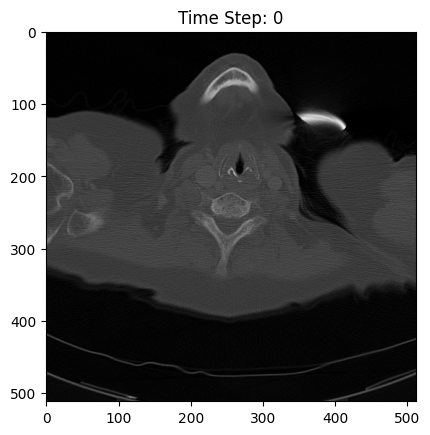

In [100]:
from IPython.display import HTML

# Display the animation
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Define the update function for the animation
def update(frame):
    plt.clf()  # Clear the current plot
    plt.imshow(vol_arr[frame], cmap='gray')  # Plot the current frame
    plt.title(f'Time Step: {frame}')  # Set the title of the plot

# Create the animation
fig = plt.figure()
ani = animation.FuncAnimation(fig, update, frames=vol_arr.shape[0], interval=200)

# Create a button to play the animation
play_button = animation.FuncAnimation(fig, lambda x: None, frames=1, interval=ani.event_source.interval, repeat=False)
play_button._start()

# Display the animation and the button
HTML(ani.to_jshtml() + play_button.to_jshtml())

In [104]:
vol = torch.from_numpy(vol_arr).float()
vol = torch.unsqueeze(vol, 0)
vol.shape

torch.Size([1, 99, 512, 512])

In [107]:
import csv 
wine_path = r"C:\Users\nq9093\CodeSpace\DeepLearningAI\DeepLearning\PyTorchBasics\repo\data\p1ch4\tabular-wine\winequality-white.csv"
wineq_numpy = np.loadtxt(wine_path, dtype=np.float32, delimiter=";", skiprows=1)
